In [35]:
import os

import numpy as np
import pandas as pd
import geopandas as gpd
from shapely import Point
from shapely.geometry import LineString

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

import pyproj
import folium

from sklearn_extra.cluster import KMedoids
from sklearn.metrics import silhouette_score

import dask

## Raw Data Overview

For this task, my focus is on analyzing geospatial timeseries data.

The data comes from a setup involving 6 LiDAR sensors strategically placed at different traffic poles around the intersection. These sensors gather raw point cloud data, which is then combined and processed within a fusion box called the Augmented LiDAR Box (ALB). The software used for this fusion process, provided by the vendor company Outsight, groups points and recognizes objects. The resulting data is organized into timeseries frames, each containing object IDs that persist across frames. In addition to IDs, each object in a frame is labeled with its class (such as `CAR`, `TRUCK`, `UNKNOWN`, `PEDESTRIAN`, or `TWO-WHEELER`), coordinates, estimated speed, volume, and more.

The preprocessed data adheres to a format defined by Outsight (Open SErialization Format or OSEF) and can be downloaded in real-time via VPN through a TCP stream.

However, I'm only able to download files of a certain size before the server closes the socket due to lag on the client (my) side. Although I played around with the TCP timeout in the `osef` library source code, the connection still fails after downloading approximately 1-2.5 GB, equivalent to several minutes of data. To address this limitation and obtain a larger dataset, I downloaded several samples during a three-day period in January 2024.

Following the download, I used Outsight's `osef` library to parse the binary OSEF files into a standard .csv format. Specifically, I extracted timestamps, object IDs, and x and y coordinates (latitude and longitude, but in a local coordinate system) from the OSEF files, focusing solely on trajectory data for this task.

In [36]:
folder_path = "C:/Users/anape/Downloads/outsight/data_csv/"
files = os.listdir(folder_path)
csv_files = [file for file in files if file.endswith('.csv')]
dataframes = [dask.delayed(pd.read_csv)(os.path.join(folder_path, file)) for file in csv_files]

@dask.delayed
def process_dataset(dataset):
    dataset['timestamp'] = pd.to_datetime(dataset['timestamp'])
    tdelta = (dataset['timestamp'].iloc[-1] - dataset['timestamp'].iloc[0]).total_seconds()
    frames = dataset['frame_number'].iloc[-1] - dataset['frame_number'].iloc[0] + 1
    #dataset['timestamp'] = dataset['timestamp'].dt.strftime('%H:%M:%S')

    overview = {
        'tracked_objects': dataset['object_id'].nunique(),
        'timedelta': round(tdelta, 1),
        'start': dataset['timestamp'].iloc[0],
        'end': dataset['timestamp'].iloc[-1],
        'frames': frames,
        'rows': len(dataset)
    }

    return overview

# Apply delayed processing to each dataset
delayed_overviews = [process_dataset(df) for df in dataframes]

# Compute the delayed computations
overviews = dask.compute(*delayed_overviews)

# Convert overviews to DataFrame
overview_df = pd.DataFrame(overviews)

overview_df

,tracked_objects,timedelta,start,end,frames,rows
0,541,110.9,2023-10-10 04:18:49.439777,2023-10-10 04:20:40.347223,2216,92895
1,181,25.8,2023-10-10 07:16:49.588081,2023-10-10 07:17:15.423061,517,17511
2,233,57.6,2023-12-01 13:18:34.992838,2023-12-01 13:19:32.624244,1152,20544
3,410,126.6,2023-12-01 13:49:17.661057,2023-12-01 13:51:24.237264,2529,43498
4,134,36.9,2023-12-01 15:11:39.030400,2023-12-01 15:12:15.978692,739,12895
5,210,52.3,2023-12-01 15:27:54.790667,2023-12-01 15:28:47.110263,1046,24218
6,154,52.3,2023-12-01 16:01:13.329284,2023-12-01 16:02:05.597886,1045,21043
7,287,91.5,2023-12-01 09:07:01.999804,2023-12-01 09:08:33.478084,1828,35383
8,340,83.9,2023-12-01 09:17:55.801213,2023-12-01 09:19:19.659996,1676,33073
9,269,89.0,2023-12-01 09:26:48.223771,2023-12-01 09:28:17.192529,1778,32721


In [37]:
print('total tracked objects:',sum(overview_df['tracked_objects']), '\ntotal time (seconds):',sum(overview_df['timedelta']), '(~', round(sum(overview_df['timedelta'])/60), 'minutes)', '\ntotal rows: ', sum(overview_df['rows']))

df = pd.concat(dask.compute(*dataframes), ignore_index=True)

total tracked objects: 35942 
total time (seconds): 15506.3 (~ 258 minutes) 
total rows:  4500895


In [38]:
df.head()

,frame_number,timestamp,object_id,class,class_id,x,y
0,0,2023-10-10 04:18:49.439777,34800377,CAR,6,28.544931,-20.992266
1,0,2023-10-10 04:18:49.439777,34800349,CAR,6,35.092129,15.421752
2,0,2023-10-10 04:18:49.439777,34799741,CAR,6,-34.818504,-13.926081
3,0,2023-10-10 04:18:49.439777,34800437,CAR,6,22.737350,10.838647
4,0,2023-10-10 04:18:49.439777,34799851,CAR,6,-39.594540,-19.450552


I then combined the individual dataframes into a frankenstein of a dataset. The combined dataframe contains 4 500 895 rows, describing the movement of 35 942 unique objects over a total (discontinuous) time of roughly 258 minutes. This is a massive dataset but after filtering and cleaning, I expect to use around 10% of it.

## Data Cleaning & Filtering
The data collection process described earlier results in incomplete trajectories. As the data is collected in intervals, many object trajectories are partial, starting or ending midway. To address this issue, I apply filtering criteria: objects tracked for less than 100 frames are omitted from the final dataset. This threshold corresponds to approximately 5 seconds of tracking at a frame rate of 20 frames/second, considering trajectories shorter than this to be potentially uninformative.

Additionally, the LiDAR detection sensor is imperfect, with some issues in object continuity. This also results in incomplete trajectories.

The trajectories represent the movement of objects at a traffic intersection, where regulated movement in lanes is expected. Lanes have defined directions, and objects within a lane typically move in the same direction, adhering to legal requirements. I used Google satellite images to create a map of the intersection's geometry, represented by polygons that capture the lanes. Each polygon is uniquely identified and contains annotations such as direction and street name. This spatial information is stored in a GeoJSON file, which can be easily processed in Python using `geopandas`.

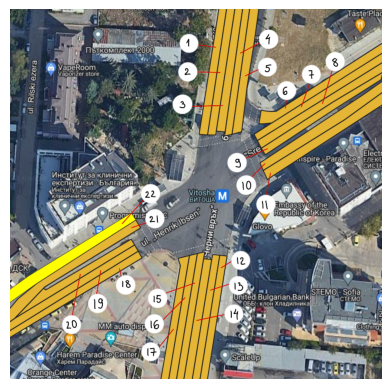

In [39]:
img = plt.imread('C:/Users/anape/OneDrive/Desktop/GATE/geojson-id.png')

plt.imshow(img)
plt.axis('off')
plt.show()

Google's satellite photos use the EPSG:3857 coordinate reference system (CRS), while the LiDAR data utilizes a local CRS centered around the ALB. Align these datasets is an affine transformation: I derived the transformation's WKT (Well-Known Text) using QGIS and Python's `pyproj` library. This WKT enables the map and data to be placed on the same scale.

With the map in place, each data point is assigned to a lane using `geopandas`' `sjoin` function, efficiently determining if a `shapely.Point` object is within a `shapely.Polygon` object.

The original trajectories are sequences of xy coordinates but can now be represented as numeric location sequences. For example, `1 1 1 1 1 0 0 0 14 14 14 ...` indicates that the object was in Polygon 1 for 5 frames, then Polygon 0 for 3 frames, followed by Polygon 14 for 3 frames, and so on.

To ensure the dataset only includes "complete" trajectories, I filter the dataframe to retain only those trajectories observed in at least one lane entering and one lane leaving the intersection.

Next, to ease clustering I categorized trajectories by the incoming street (Henrik Ibsen St, Sreburna St, Cherni Vruh North, and Cherni Vruh South) by manually filtering based on the Polygon IDs.

Splitting by incoming street is helpful for 2 reasons:
1. **Determining clusters**: The split makes it easier to visually distinguish clusters. For each of the incoming streets, you can easily see and count possible directions. This is not the case when the trajectories are all plotted together.
2. **Computing distance matrices**: Clustering is done using K-medoids method, for its interpretibiltity and flexibility to handle data with different sizes (trajectories with different number of points). K-medoids creates clusters based on a provided distance matrix. The distance matrix is symmetric contains information about the distance between each two instances in the dataset. The current dataset has ~2200 trajectories. This means that a symmetric distance matrix of all 2200 entries requires $\frac{n(n+1)}{2}=2421100$ calculations. Assuming trajectories are roughly equally distributed among clusters, each cluster would have ~600 entries. Calculating 4 distance matrices with 600 entries each requires $4 \times \frac{601 \times 600}{2} = 721200$ calculations, which is just $\frac{1}{3}$ of the aforementioned 2 000 000 calculations.

In [40]:
def points(df):
    '''
    Creates a geodataframe with shapely.Point objects from 'x' and 'y' coordinates.

    :param df: pandas.DataFrame with 'x' and 'y' columns
    :return: geopandas dataframe with Point as geometry column.
    '''
    df['geometry'] = df.apply(lambda row: Point(row['x'], row['y']), axis=1)

    # Create a geodataframe & set CRS to avoid CRS mismatch issues later
    # (NOTE: this may not be the real CRS of the trajectories) 
    points_df = gpd.GeoDataFrame(df, geometry='geometry')
    points_df.crs = 'EPSG:3857'
    return points_df

def linestrings(df):
    '''
    Groups data by 'object_id' and creates shapely.Linestring objects in a new geodataframe.

    :param df: pandas.DataFrame with 'object_id', 'x' and 'y' columns
    :return: geopandas dataframe with Linestring as geometry column.
    '''
    linestring_df = gpd.GeoDataFrame(geometry=gpd.GeoSeries())

    for i, group in df.groupby('object_id'):
        geometry = LineString([xy for xy in zip(group.x, group.y)])
        linestring_df.loc[i,'geometry'] = geometry
        linestring_df.loc[i,'object_id'] = i

    # Create a geodataframe & set CRS to avoid CRS mismatch issues later
    # (NOTE: this may not be the real CRS of the trajectories)      
    linestring_df.crs = 'EPSG:3857'
    return linestring_df


In [41]:
zones = gpd.read_file("C:/Users/anape/Downloads/outsight/resources/QGIS/lanes_and_int.geojson")
zones_3857 = gpd.read_file("C:/Users/anape/Downloads/outsight/resources/QGIS/intersection-all-3857.geojson")
#idstoremove = [5556806,882952,887109,875432,7549619,6226753,862651,34799952,5589942,5590883,5562677]

gdf = points(df)
#gdf = gdf[~gdf['object_id'].isin(idstoremove)]
joined_gdf = gpd.sjoin(gdf, zones[['id','geometry','direction','to_inter']], how="left")


In [42]:
# Filtering and categorizing trajectories based on incoming streets
streets = {
    'henrik_ibsen': [],
    'sreburna': [],
    'cherni_vruh_N': [], # N = north heading
    'cherni_vruh_S': [] #S = south heading
}

for i, group in joined_gdf.groupby('object_id'):
    
    # Filtering out objects tracked for less than 5 seconds, given frame rate = 20 f/s
    if len(group) > 100:

        ids = set(group['id'])
        to_inter = set(group['to_inter'])
        
        # If the object is detected both in lanes coming and leaving the intersection.
        if (0 in ids or 6 in ids) and (1 in to_inter and 0 in to_inter):

            # If the object is detected in the lanes of interest, excluding the closest neighboring lane with opposite direction to remove noise
            if (1 in ids or 2 in ids or 3 in ids) and 4 not in ids:
                streets['cherni_vruh_S'].append(i)
            elif (6 in ids or 7 in ids or 8 in ids or 9 in ids) and 10 not in ids:
                streets['sreburna'].append(i)
            elif (12 in ids or 13 in ids or 14 in ids) and 15 not in ids:
                streets['cherni_vruh_N'].append(i)
            elif (18 in ids or 19 in ids or 20 in ids) and (21 not in ids and 22 not in ids):
                streets['henrik_ibsen'].append(i)

The exact number of trajectories in the dataset (visualized below) is 2234.

In [43]:
count = 0
for i in streets:
    count+= len(streets[i])
    print(len(streets[i]))

count

543
470
607
614


2234

This step - splitting the dataset into 4 based on incoming street - is done for clarity and data cleaning purposes. Looking at the 4 plots above gives me a lot more intuition and information about the data than looking at all trajectories plotted all together. The clusters are clearly visible and informative: the cars incoming from each street have 2 or 3 possible directions.

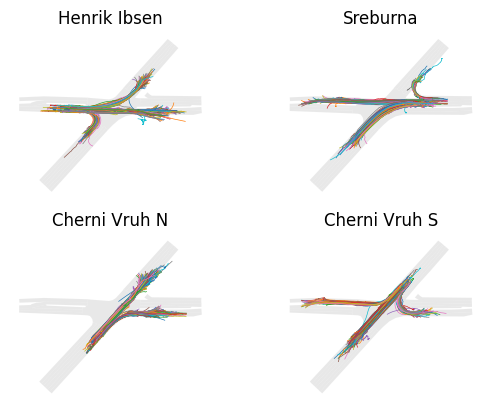

In [44]:
# Plotting the results
fig, axes = plt.subplots(2, 2)
flat_axes = axes.ravel()

for street_name, ax in zip(streets.keys(), flat_axes):
    zones.plot(color='lightgray', alpha=0.5, ax=ax)
    for i, group in joined_gdf[joined_gdf['object_id'].isin(streets[street_name])].groupby('object_id'):   
        ax.plot(group['x'], group['y'],linewidth=0.5)
    ax.set_title(street_name.replace('_', ' ').title())
    ax.axis('off')

plt.show()

This is fairly small dataset. One way to increase its volume is through data augmentation. It is important that a model is not fed more of the same identical data. Rather, the data should be augmented in a way that maintains or increases diversity. For image data, this usually means zooming in and out, blurring, manipulating color, etc. For time series geospatial data, data augmentation can be done through sampling. Each trajectory is sampled multiple times to produce multiple trajectories.

However, this data augmentation should be done once trajectories are labeled in order to keep the clustering task manageable. Sampling trajectories from one "parent" trajectory produces trajectories from the cluster of the parent trajectory. Therefore, it makes sense to label a trajectory, then sample it. 

## Data Labeling
The plot above shows that each group contains a few easily distinguishable clusters of the trajectories based on whether they turn left, right or keep straight. The next step is to label each of these clusters.

To do so, I use K-medoids clustering with Hausdorff distance as distance measure between trajectories.

K-medoids is a partitioning method for clustering data into K distinct groups. Unlike K-means, which uses centroids to represent cluster centers, K-medoids uses medoids - meaning actual data points or trajectories in this case - as the center of each cluster. The input is a distance matrix $D \in R^{n \times n}$, where $n$ is the number of trajectories. The distance matrix is symmetric and shows the distane between all datapoints.

### Hausdorff distance
For polyline data (trajectories), I chose Hausdorff distance as the distance measure. The Hausdorff distance measures the similarity between two sets of points in a space, or how far two sets are from being identical. Given two sets of points A and B, the Hausdorff distance is defined as:
$$\text{Hausdorff}(A, B) = \max\left(\sup_{a \in A} \inf_{b \in B} d(a, b), \sup_{b \in B} \inf_{a \in A} d(b, a)\right)$$

- $d(a, b)$ represents the distance metric (in this case, Euclidean distance);
- $\sup$ denotes the supremum, which is the least upper bound;
- $\inf$ represents the infimum, which is the greatest lower bound.

The formula can be interpreted as:
1. Find the greatest distance of a point in A to the closest point in B.
2. Then find the greatest distance of a point in B to the closest point in A.
3. The Hausdorff distance is the greater of these two.

### K-medoids
Once the distance matrix $D$ is precomputed, the K-medoids algorithm seeks to minimize the Hausdorff distance between medoids and the points within their respective clusters. Framing this as an optimization problem, the algorithm works as follows:

1. Choose K initial medoids randomly.
2. Assign each data point to the nearest medoid.
3. For each medoid, calculate the total cost, which is the sum of distances from the medoid to the points assigned to it.
4. Swap a non-medoid point with the medoid and recompute the total cost. If the cost decreases, keep the swap; otherwise, revert.
5. Repeat steps 2-4 until convergence (reaching specified threshold or number of iterations).

Mathematically, let:
- $n$ be the total number of data points;
- $D$ be the distance matrix;
- $K$ be the number of clusters;
- $M = \{m_1, m_2, \dots, m_K\}$ be the set of medoids.

- $x_{ij}$ be a binary variable representing whether data point $i$ is assigned to medoid $j$. 


The objective function is to minimize the total dissimilarity between data points and their assigned medoids:
$$\text{minimize:} \sum_{i=1}^{n} \sum_{j=1}^{K} D_{ij} \cdot x_{ij} $$

with constraints:
$$\text{(1) } \sum_{j=1}^{K} x_{ij} = 1 \quad \text{for } i = 1, 2, \dots, n$$
$$\text{(2) } x_{ij} = 1 \quad \text{for } j = 1, 2, \dots, K$$

where (1) means each data point must be assigned to exactly one medoid, and (2) means medoids are selected from the available data points.


### Application
I calculated the distance matrices for each group using the readily available `shapely.Linestring.hausdorff()` method.

Then I implemented K-medoids clustering using the `scikit-learn` library. For each of the 4 groups of trajectories, I chose the number of clusters based on visual inspection of the plot above. All streets except Cherni Vruh N, which is assigned K=2, have K=3 clusters.

A visualization of the results is shown below.

In [45]:
def hausdorff_distance(line1, line2):
    '''
    :param line1: shapely.Linestring object
    :param line2: shapely.Linestring object

    :return: Hausdorff distance between the two lines (float)
    '''
    return line1.hausdorff_distance(line2)

@dask.delayed
def compressed_dist_matrix(gdf):
    '''
    :param filename: path to csv file
    :param compression: compression as %, default = 50

    :return: distance_matrix as a list of list, object_ids list of ordered id's corresponding to matrix indices
        
    '''
    object_ids = gdf['object_id'].unique()

    # Initializing n x n empty matrix
    n_trajectories = len(object_ids)
    distance_matrix = [[0 for _ in range(n_trajectories)] for _ in range(n_trajectories)]

    # Calculate distances and fill in the distance matrix
    for i in range(n_trajectories):
        for j in range(i, n_trajectories):  # Matrix is symmetric, so upper triangle is enough

            # Fetching LineStrings based on object_ids list
            line1 = gdf.loc[gdf['object_id'] == object_ids[i], 'geometry'].iloc[0]
            line2 = gdf.loc[gdf['object_id'] == object_ids[j], 'geometry'].iloc[0]
            
            distance = hausdorff_distance(line1, line2)
            distance_matrix[i][j] = distance
            distance_matrix[j][i] = distance

    return distance_matrix#, object_ids

@dask.delayed
def cluster_medoids(distance_matrix, gdf, n):
    '''
    :param dist_matrix: dist_matrix of the trajectories to be clustered
    :param gdf: geodataframe with LineStrings
    :param n: number of clusters

    :return: gdf with cluster labels under a column 'cluster'
    '''
    kmedoids = KMedoids(n_clusters=n, random_state=156)
    kmedoids.fit(distance_matrix)

    cluster_labels = kmedoids.labels_
    medoid_indices = kmedoids.medoid_indices_

    # Calculate silhouette score as an evaluation metric
    silhouette = silhouette_score(distance_matrix, cluster_labels)

    gdf['cluster'] = cluster_labels  # Assign cluster labels to geodatadrame

    return gdf, round(silhouette,3), medoid_indices

In [46]:
streets_linestring_gdf = {}
distance_matrices = {}
street_medoids = {}
silhouette_scores = {}

tasks = []
for s in streets.keys():
    linestring_df = linestrings(gdf[gdf['object_id'].isin(streets[s])])
    
    if s in ['henrik_ibsen', 'sreburna', 'cherni_vruh_S']:
        nclusters = 3
    else:
        nclusters = 2

    # distance matrix    
    distance_matrices[s] = compressed_dist_matrix(linestring_df)

    # clustering
    task = cluster_medoids(distance_matrices[s], linestring_df, nclusters)
    tasks.append(task)

# Execute the tasks in parallel
results = dask.compute(*tasks)

# Unpack the results
for i, s in enumerate(streets.keys()):
    streets_linestring_gdf[s], silhouette_scores[s], street_medoids[s] = results[i]

c:\Users\anape\Downloads\outsight\venv\Lib\site-packages\shapely\measurement.py:224: RuntimeWarning: invalid value encountered in hausdorff_distance
  return lib.hausdorff_distance(a, b, **kwargs)
c:\Users\anape\Downloads\outsight\venv\Lib\site-packages\shapely\measurement.py:224: RuntimeWarning: invalid value encountered in hausdorff_distance
  return lib.hausdorff_distance(a, b, **kwargs)
c:\Users\anape\Downloads\outsight\venv\Lib\site-packages\shapely\measurement.py:224: RuntimeWarning: invalid value encountered in hausdorff_distance
  return lib.hausdorff_distance(a, b, **kwargs)
c:\Users\anape\Downloads\outsight\venv\Lib\site-packages\shapely\measurement.py:224: RuntimeWarning: invalid value encountered in hausdorff_distance
  return lib.hausdorff_distance(a, b, **kwargs)


Since K-medoids clustering is an unsupervised learning method, evaluation of the results might not be as straight-forward since there is no ground truth.

Luckily, trajectories can be very intuitively interpreted visually. I plot the clusters (again, split by incoming street) to visualize the output of the K-medoids algorithm.

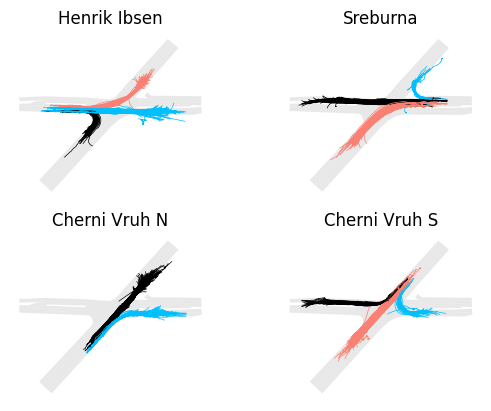

In [47]:
# Plotting the results
color_map = {0: 'deepskyblue', 1: 'k', 2: 'salmon'}

fig, axes = plt.subplots(2, 2)
flat_axes = axes.ravel()

for k, ax in zip(streets_linestring_gdf.keys(), flat_axes):
    zones.plot(color='lightgray', alpha=0.5, ax=ax)
    mydata = streets_linestring_gdf[k]
    colors = mydata['cluster'].map(color_map)
    mydata.plot(color=colors,linewidth=0.5,ax=ax)


    legend_handles = [mpatches.Patch(color=color, label=f'{cluster}') for cluster, color in color_map.items()]
    #ax.legend(handles=legend_handles,loc='lower right',prop={'size': 5})

    ax.set_title(k.replace('_', ' ').title())
    ax.axis('off')

plt.show()

In [55]:
dms = dask.compute(*distance_matrices.values())
for i, key in enumerate(distance_matrices.keys()):
    distance_matrices[key] = dms[i]

c:\Users\anape\Downloads\outsight\venv\Lib\site-packages\shapely\measurement.py:224: RuntimeWarning: invalid value encountered in hausdorff_distance
  return lib.hausdorff_distance(a, b, **kwargs)


One of the reasons why K-medoids is suitable for this use case is its high interpretability. Trajectories are clustered around medoids, which are points (trajectories) from the data. Here are the medoids selected by the algorithm.

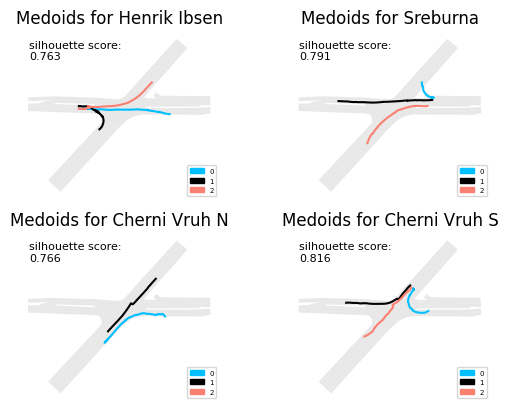

In [59]:
fig, axes = plt.subplots(2,2)
for i, ax in enumerate(axes.flatten()):
    k = list(streets.keys())[i]
    zones.plot(color='lightgray', alpha=0.5, ax=ax)
    mydata = streets_linestring_gdf[k]

    indices = street_medoids[k]
    mydata = mydata.iloc[indices]

    colors = mydata['cluster'].map(color_map)
    mydata.plot(color=colors,ax=ax)
    legend_handles = [mpatches.Patch(color=color, label=f'{cluster}') for cluster, color in color_map.items()]
    ax.legend(handles=legend_handles,loc='lower right',prop={'size': 5})

    ax.set_title('Medoids for '+k.replace('_', ' ').title())
    ax.axis('off')
    ax.text(0.05, 0.95, f'silhouette score:\n{silhouette_scores[k]}', ha='left', va='top', fontsize=8, color='black', transform=ax.transAxes)
plt.show()

A more robust evaluation of K-medoids includes looking into metrics like silhouette score, homogeneity, completeness, and V-measure, all supported by the `scikit-learn` library. 

Since I only use K-medoids to label my data, I will not spend too much time on calculating and evaluating all metrics. I chose to look into silhouette scores as a relatively holistic measure of the models' perfomance. Silhouette score is used to evaluate the quality of clusters. It quantifies how similar an object is to its own cluster (cohesion) compared to other clusters (separation).

The silhouette score for a single sample is calculated as:

$$ s = \frac{b - a}{\max(a, b)} $$

where:
- $a$ is the mean distance between a sample and all other points in the same cluster;
- $b$ is the mean distance between a sample and all other points in the next nearest cluster (the nearest cluster that the sample is not part of).

Silhouette scores range from -1 to 1. Higher values (closer to 1) indicate better-defined clusters, while a score closer to -1 suggests that the data points might have been assigned to the wrong clusters.



In [57]:
for s in streets.keys():
    streets_linestring_gdf[s]['object_id'] = streets_linestring_gdf[s]['object_id'].astype(int)
    for num, m in enumerate(street_medoids[s]):
        streets_linestring_gdf[s][num] = distance_matrices[s][m]

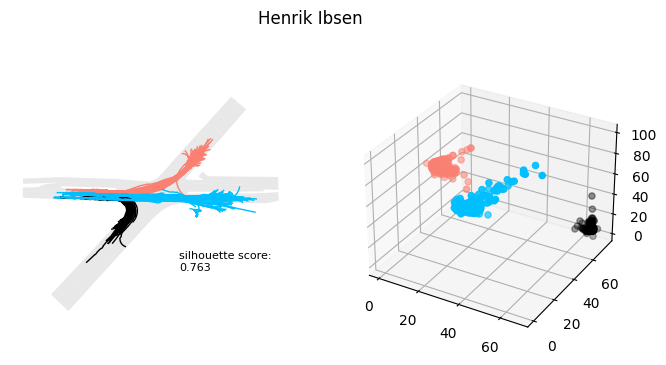

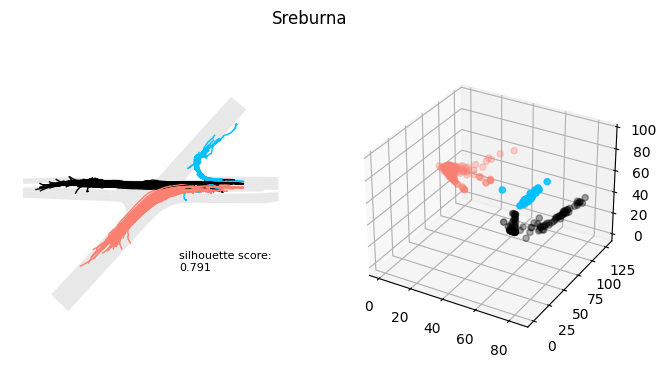

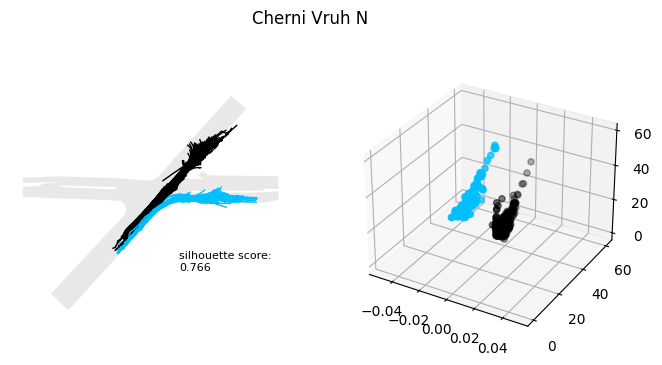

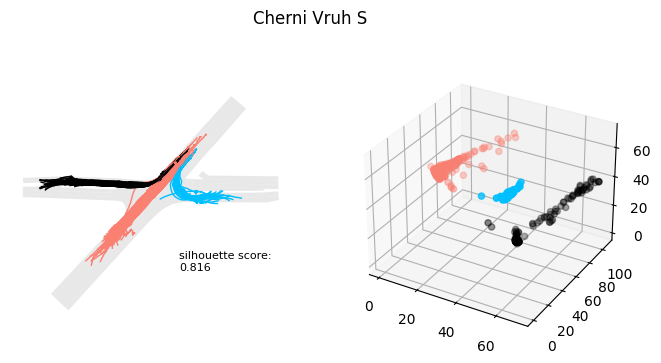

In [63]:
#plt.scatter(streets_linestring_gdf[street_name][2],streets_linestring_gdf[street_name][1], c=streets_linestring_gdf[street_name]['cluster'])
for street_name in streets.keys():
    color_map = {0: 'deepskyblue', 1: 'black', 2: 'salmon'}
    colors = streets_linestring_gdf[street_name]['cluster'].map(color_map)


    fig, ax = plt.subplots(1, 2, figsize=(8, 4))

    # Plot the first subplot with light gray zones and streets_linestring_gdf
    zones.plot(color='lightgray', alpha=0.5,ax=ax[0])
    streets_linestring_gdf[street_name].plot(color=colors, linewidth=1, ax=ax[0])
    ax[0].text(0.6, 0.3, f'silhouette score:\n{silhouette_scores[street_name]}', ha='left', va='top', fontsize=8, color='black', transform=ax[0].transAxes)

    ax[0].axis('off')

    # remove 2nd plot and add a 3d one
    ax[1].remove()
    ax[1] = fig.add_subplot(1, 2, 2, projection='3d')
    if 2 in streets_linestring_gdf[street_name].columns:
        ax[1].scatter(
            streets_linestring_gdf[street_name][2],
            streets_linestring_gdf[street_name][0],
            streets_linestring_gdf[street_name][1],
            c=colors
        )
    else:
        ax[1].scatter(
            np.zeros(len(streets_linestring_gdf[street_name][0])),
            streets_linestring_gdf[street_name][0],
            streets_linestring_gdf[street_name][1],
            c=colors
        )
    plt.suptitle(street_name.replace('_', ' ').title())
    # Show the plots
    plt.show()

The plot above shows the clustering procedure produces the correct classification for seemingly all trajectories. The data itself is a bit noisy but overall, the K-medoids algorithm seems like an efficient way to label the data.

The achieved silhouette scores are similar across all datasets and being in the range 0.7-0.9 are generally considered good, indicating cohesive and reasonably well-separated clusters.

The final step is to combine the 4 datasets into a single dataset.

In [64]:
# Offsetting the clusters' names before combining into a single dataframe
streets_linestring_gdf['henrik_ibsen']['cluster'] += 0
streets_linestring_gdf['sreburna']['cluster'] += 3
streets_linestring_gdf['cherni_vruh_S']['cluster'] += 6
streets_linestring_gdf['cherni_vruh_N']['cluster'] += 9

# Combining into a single dataframe
combined_df = pd.concat([k for k in streets_linestring_gdf.values()])

# Reset
streets_linestring_gdf['henrik_ibsen']['cluster'] += 0
streets_linestring_gdf['sreburna']['cluster'] -= 3
streets_linestring_gdf['cherni_vruh_S']['cluster'] -= 6
streets_linestring_gdf['cherni_vruh_N']['cluster'] -= 9

Here is what the combined dataframe contains:

In [65]:
print(
    'tracked objects:', len(combined_df),
    '\nclusters:', combined_df['cluster'].nunique(),
    '\n% from original dataset:', round(len(df[df['object_id'].isin(combined_df.index)])/len(df)*100,2)
    )

cluster_counts = combined_df['cluster'].value_counts().reset_index()
cluster_counts.columns = ['Cluster', 'Count']
cluster_counts

tracked objects: 2234 
clusters: 11 
% from original dataset: 20.91


,Cluster,Count
0,10,350
1,8,332
2,9,257
3,1,207
4,5,197
5,2,171
6,0,165
7,3,150
8,7,150
9,6,132


The final dataset contains 2234 tracked objects split into 11 clusters. The split between clusters is not balanced, with counts ranging form 123 to 350.

And as I guessed in the beginning, the final dataset is compiled with only a fraction (20%) of the rows from the initial dataframe but hey that's the price you pay for clean-ish data.

All together, this is what the combined dataframe looks like.

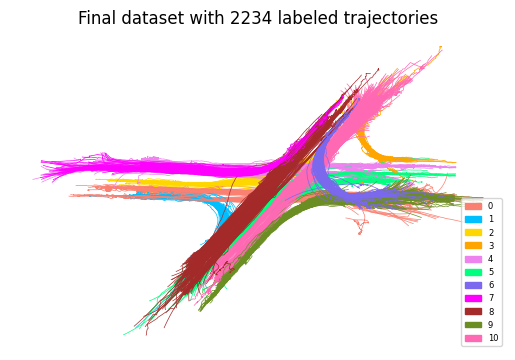

In [66]:
# Plotting the final dataframe
color_map = {
    0: 'salmon', 1: 'deepskyblue', 2: 'gold', 3: 'orange', 4: 'violet',
    5: 'springgreen', 6: 'mediumslateblue', 7: 'magenta', 8: 'brown', 9: 'olivedrab', 10: 'hotpink'
}

fig, ax = plt.subplots()
colors = combined_df['cluster'].map(color_map)
#zones.plot(color='lightgray',ax=ax)
combined_df.plot(color=colors,linewidth=0.5,ax=ax)
ax.axis("off")
legend_handles = [mpatches.Patch(color=color, label=f'{cluster}') for cluster, color in color_map.items()]
ax.legend(handles=legend_handles,loc='lower right',prop={'size': 6})
ax.set_title(f'Final dataset with {len(combined_df)} labeled trajectories')
plt.show()

Finally, let's save the dataframe into a file.

In [69]:
tosavedf = combined_df.drop(columns=[0, 1, 2]) # remove distance from cluster
tosavedf.to_file('labeled_trajectories-all1.geoJSON', driver='GeoJSON')

________________________________________________
# Visualizations

Below you can find a an interactive visualization map made with `folium`. There is a slight mismatch between the satellite image and the intersection geometry as `folium` works with OpenStreetMap satellite photos, while I used Google's to create the map.

Added the map here: https://anapeykova.github.io/GATE-intersection-trajectories/maps/labeled_trajectories_map.html



In [ ]:
# WKT for local to EPSG:3857 CRS
source_crs_wkt = 'DERIVEDPROJCRS["",BASEPROJCRS["WGS 84 / Pseudo-Mercator",BASEGEOGCRS["WGS 84",ENSEMBLE["World Geodetic System 1984 ensemble",MEMBER["World Geodetic System 1984 (Transit)"],MEMBER["World Geodetic System 1984 (G730)"],MEMBER["World Geodetic System 1984 (G873)"],MEMBER["World Geodetic System 1984 (G1150)"],MEMBER["World Geodetic System 1984 (G1674)"],MEMBER["World Geodetic System 1984 (G1762)"],MEMBER["World Geodetic System 1984 (G2139)"],ELLIPSOID["WGS 84",6378137,298.257223563,LENGTHUNIT["metre",1]],ENSEMBLEACCURACY[2.0]],PRIMEM["Greenwich",0,ANGLEUNIT["degree",0.0174532925199433]],ID["EPSG",4326]],CONVERSION["Popular Visualisation Pseudo-Mercator",METHOD["Popular Visualisation Pseudo Mercator",ID["EPSG",1024]],PARAMETER["Latitude of natural origin",0,ANGLEUNIT["degree",0.0174532925199433],ID["EPSG",8801]],PARAMETER["Longitude of natural origin",0,ANGLEUNIT["degree",0.0174532925199433],ID["EPSG",8802]],PARAMETER["False easting",0,LENGTHUNIT["metre",1],ID["EPSG",8806]],PARAMETER["False northing",0,LENGTHUNIT["metre",1],ID["EPSG",8807]]]],DERIVINGCONVERSION["Affine",METHOD["Affine parametric transformation",ID["EPSG",9624]],PARAMETER["A0",-3716438.1093590977,LENGTHUNIT["metre",1],ID["EPSG",8623]],PARAMETER["A1",0.6158540384148486,SCALEUNIT["coefficient",1],ID["EPSG",8624]],PARAMETER["A2",0.40263073503547436,SCALEUNIT["coefficient",1],ID["EPSG",8625]],PARAMETER["B0",-2194507.2465994842,LENGTHUNIT["metre",1],ID["EPSG",8639]],PARAMETER["B1",-0.40263073503547436,SCALEUNIT["coefficient",1],ID["EPSG",8640]],PARAMETER["B2",0.6158540384148486,SCALEUNIT["coefficient",1],ID["EPSG",8641]]],CS[Cartesian,2],AXIS["easting (X)",east,ORDER[1],LENGTHUNIT["metre",1]],AXIS["northing (Y)",north,ORDER[2],LENGTHUNIT["metre",1]]]'
target_crs_wkt = 'EPSG:3857' 

transformer = pyproj.Transformer.from_crs(source_crs_wkt, target_crs_wkt, always_xy=True)
transformed_gdf = combined_df.copy(deep=True)

def transform_geometry(geometry):
    # Transform the xy coordinates of the geometry
    transformed_coords = transformer.transform(geometry.xy[0], geometry.xy[1])
    # Create a new LineString with the transformed coordinates
    return LineString(zip(*transformed_coords))

transformed_gdf['geometry'] = combined_df['geometry'].apply(transform_geometry)

In [ ]:
# Interactive plot of the final dataset
map_clusters = folium.Map(location=[42.659395820532694, 23.3165594735582],zoom_start=50,tiles=None)


# basemap satellite layer
folium.TileLayer(
    tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
    attr='Esri',
    name='Esri Satellite',
    overlay=False,
    control=True
).add_to(map_clusters)

geojson = folium.GeoJson(zones_3857, name=f'Zones')
geojson.add_to(map_clusters)
grouped_clusters = transformed_gdf.groupby('cluster')

color_palette = list(color_map.values())
# for _ in range(11):
#     color = "#{:02x}{:02x}{:02x}".format(random.randint(0, 255), random.randint(0, 255), random.randint(0, 255))
#     color_palette.append(color)

# Loop through the groups and add them as separate GeoJson layers with custom colors
for i, (cluster, data) in enumerate(grouped_clusters):
    # Assign a custom color from the palette or use random color if more clusters than colors
    color = color_palette[i % len(color_palette)]
    
    geojson = folium.GeoJson(data, name=f'Cluster {cluster}', style_function=lambda x, color=color: {'color': color})
    geojson.add_to(map_clusters)

# add a LayerControl to the map
folium.LayerControl().add_to(map_clusters)

display(map_clusters)
